In [1]:
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split, StratifiedKFold
from sklearn.feature_selection import mutual_info_classif
from matplotlib import pyplot as plt
from sklearn.mixture import GaussianMixture
from sklearn.manifold import TSNE
from sklearn.decomposition import PCA, NMF, FastICA
from sklearn.cluster import KMeans
import seaborn as sns
from sklearn.model_selection import GridSearchCV, RandomizedSearchCV
from sklearn.pipeline import Pipeline
from sklearn.svm import SVC, LinearSVC
from sklearn.metrics import log_loss, make_scorer, classification_report, f1_score
from sklearn.dummy import DummyClassifier
from sklearn.random_projection import GaussianRandomProjection
from sklearn.ensemble import RandomForestClassifier
from sklearn.neighbors import KNeighborsClassifier
%matplotlib inline
plt.rcParams['figure.dpi']=600

In [2]:
data = pd.read_pickle('../Data/ProstateMulti.pkl')
Prostate = data.copy(deep=True)
Prostate.drop('Target',axis=1, inplace=True)
Target = data['Target']

In [3]:
Target.value_counts()

0    154
5    127
2    122
3     79
4     60
1     38
Name: Target, dtype: int64

In [4]:
Healthy = data[data['Target'] == 0]
S1 = data[data['Target'] == 1]
S2 = data[data['Target'] == 2]
S3 = data[data['Target'] == 3]
S4 = data[data['Target'] == 4]
S5 = data[data['Target'] == 5]

# Test-Train Split

Split them separetely to keep even ratios

In [5]:
X_train, X_test, y_train, y_test = train_test_split(Prostate, Target, test_size=0.2, random_state=42, stratify = Target)

# Dimensionality Reduction

## Feature Selection

### Mutual Information on Combined Data (NO TT SPLIT)

In [286]:
mic = mutual_info_classif(Prostate,Target)

In [287]:
summary = pd.DataFrame({"MutualInfo":mic,
                       'GeneID':Prostate.columns})

In [288]:
summary.to_pickle("../Data/MI_Grades_NoSplit5.pkl")

In [6]:
summary = pd.read_pickle('../Data/MI_Grades_NoSplit5.pkl')

In [7]:
top_nosplit = np.hstack([summary.sort_values('MutualInfo',ascending=False).head(5)["GeneID"].values,['Target']])

### Mutual Information on Combined Data (WITH TT SPLIT)

In [291]:
micsplit = mutual_info_classif(X_train,y_train)

In [292]:
summary_split = pd.DataFrame({"MutualInfo":micsplit,
                       'GeneID':X_train.columns})

In [293]:
summary_split.to_pickle("../Data/MI_Grades_Split5.pkl")

In [8]:
summary_split = pd.read_pickle("../Data/MI_Grades_Split5.pkl")

In [9]:
top_split = np.hstack([summary_split.sort_values('MutualInfo',ascending=False).head(5)["GeneID"].values])

In [10]:
X_train_MI = X_train[top_split]
X_test_MI = X_test[top_split]

## Feature Extraction

# Unsupervised Learning

## GMM

In [11]:
data = data[top_nosplit]
#ProstateReduced1 = PCA(n_components=5).fit_transform(data.drop("Target",axis=1))
ProstateReduced2 = TSNE(n_components=2).fit_transform(data.drop("Target", axis=1))
model = GaussianMixture(n_components=6)
model.fit(ProstateReduced2)

GaussianMixture(covariance_type='full', init_params='kmeans', max_iter=100,
        means_init=None, n_components=6, n_init=1, precisions_init=None,
        random_state=None, reg_covar=1e-06, tol=0.001, verbose=0,
        verbose_interval=10, warm_start=False, weights_init=None)

In [12]:
nameDict = {0:"Healthy", 1:"Grade 1", 2:"Grade 2", 3:"Grade 3", 4:"Grade 4", 5:"Grade 5"}

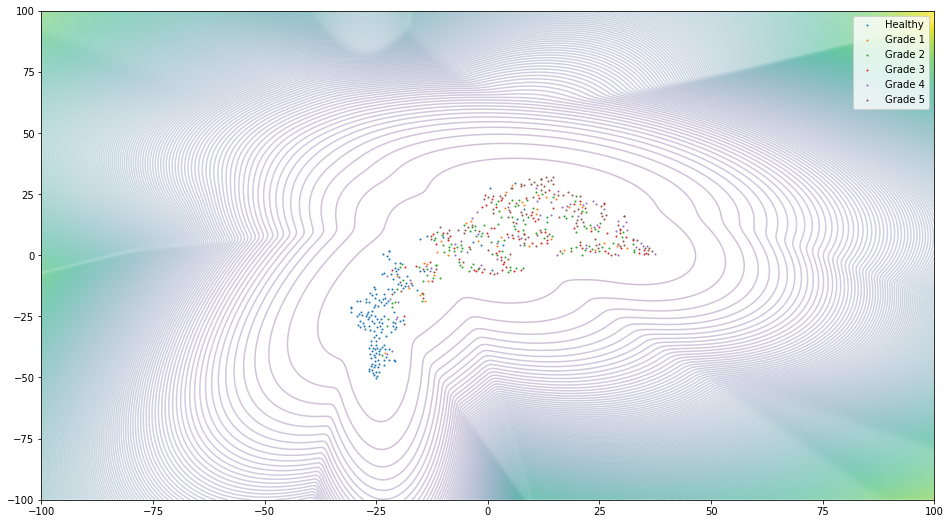

In [13]:
fig,axs = plt.subplots(figsize=(16,9))
x = np.linspace(-100., 100.,num=300)
y = np.linspace(-100., 100.,num=300)
X, Y = np.meshgrid(x, y)
XX = np.array([X.ravel(), Y.ravel()]).T
Z = -model.score_samples(XX)
Z = Z.reshape(X.shape)

CS = axs.contour(X, Y, Z,levels=np.sqrt(np.linspace(np.min(Z),np.max(Z)**2,400)),alpha=.25)

for i in range(6):
    dslice = [np.where(data["Target"]==i)[0]]

    axs.scatter(ProstateReduced2[:,0][dslice],ProstateReduced2[:,1][dslice],s=1,label=nameDict[i])
    
axs.legend()

Comments on the GMM:
This technique seems very unstable, in the first part changing PCA components changes things drastically, in the second part even rerunning the same code can produce very different results

Nonetheless, I wasn't able to get any clear separation, which doesn't bode well for the statistical separability of the different Grades

## K-Means

# Supervised Learning

## SVM, LinearSVM, and RF

At some point I need to figure out the inner/outer cv thing

### Finding the Best Features

In [14]:
pipe = Pipeline([
    ('classify', SVC())])

In [15]:
GAMMA_OPTIONS = [1e-3, 1e-4]
C_OPTIONS = [1, 10, 100, 1000]

N_NEIGHBORS_OPTIONS = list(range(1,30))

n_estimators = [10,20,40]
max_depth = [5, None]
min_samples_split = [2, 5, 10]
min_samples_leaf = [1, 2, 4]


param_grid = [ 
     {
        'classify': [LinearSVC()],
        'classify__C': C_OPTIONS, 
    },
    {
        'classify': [SVC()],
        'classify__C': C_OPTIONS,
        'classify__kernel': ['rbf'], 
        'classify__gamma': GAMMA_OPTIONS,
    },
    {
        'classify': [RandomForestClassifier()],
        'classify__n_estimators': n_estimators,
        'classify__max_depth': max_depth,
        'classify__min_samples_split': min_samples_split,
        'classify__min_samples_leaf': min_samples_leaf,
    },
    {
        'classify': [KNeighborsClassifier()],
        'classify__n_neighbors': N_NEIGHBORS_OPTIONS,
    },
]



In [16]:
ll_scorer = make_scorer(log_loss, sample_weight='balanced')

In [17]:
scoring = make_scorer(f1_score, average='macro')

In [18]:
clf = GridSearchCV(pipe, param_grid, cv=StratifiedKFold(n_splits=5, shuffle=True, random_state=42), iid = False, verbose = 10, scoring=scoring, n_jobs=-1)

In [19]:
clf.fit(X_train_MI, y_train)

Fitting 5 folds for each of 95 candidates, totalling 475 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done   5 tasks      | elapsed:   16.2s
[Parallel(n_jobs=-1)]: Done  10 tasks      | elapsed:   16.4s
[Parallel(n_jobs=-1)]: Done  17 tasks      | elapsed:   16.8s
[Parallel(n_jobs=-1)]: Done  24 tasks      | elapsed:   17.1s
[Parallel(n_jobs=-1)]: Done  33 tasks      | elapsed:   17.3s
[Parallel(n_jobs=-1)]: Batch computation too fast (0.1868s.) Setting batch_size=2.
[Parallel(n_jobs=-1)]: Done  42 tasks      | elapsed:   17.4s
[Parallel(n_jobs=-1)]: Done  61 tasks      | elapsed:   18.2s
[Parallel(n_jobs=-1)]: Done  83 tasks      | elapsed:   19.0s
[Parallel(n_jobs=-1)]: Done 109 tasks      | elapsed:   20.0s
[Parallel(n_jobs=-1)]: Done 135 tasks      | elapsed:   21.6s
[Parallel(n_jobs=-1)]: Done 165 tasks      | elapsed:   23.1s
[Parallel(n_jobs=-1)]: Done 195 tasks      | elapsed:   24.5s
[Parallel(n_jobs=-1)]: Done 229 tasks      | elapsed:   26.4s
[Parallel(n_jobs=-1)]: Done 263 tas

GridSearchCV(cv=StratifiedKFold(n_splits=5, random_state=42, shuffle=True),
       error_score='raise-deprecating',
       estimator=Pipeline(memory=None,
     steps=[('classify', SVC(C=1.0, cache_size=200, class_weight=None, coef0=0.0,
  decision_function_shape='ovr', degree=3, gamma='auto_deprecated',
  kernel='rbf', max_iter=-1, probability=False, random_state=None,
  shrinking=True, tol=0.001, verbose=False))]),
       fit_params=None, iid=False, n_jobs=-1,
       param_grid=[{'classify': [LinearSVC(C=1.0, class_weight=None, dual=True, fit_intercept=True,
     intercept_scaling=1, loss='squared_hinge', max_iter=1000,
     multi_class='ovr', penalty='l2', random_state=None, tol=0.0001,
     verbose=0)], 'classify__C': [1, 10, 100, 1000]}, {'classify': [SVC(C=1... 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]}],
       pre_dispatch='2*n_jobs', refit=True, return_train_score='warn',
       scoring=make_scorer(f1_score, average=macro)

In [20]:
print("Best parameters set found on development set:")
print()
print(clf.best_params_)
print()
print("Grid scores on development set:")
print()
means = clf.cv_results_['mean_test_score']
stds = clf.cv_results_['std_test_score']
for mean, std, params in zip(means, stds, clf.cv_results_['params']):
    print("%0.3f (+/-%0.03f) for %r"
            % (mean, std * 2, params))
print()

print("Detailed classification report:")
print()
print("The model is trained on the full development set.")
print("The scores are computed on the full evaluation set.")
print()
y_true, y_pred = y_test, clf.predict(X_test_MI)
print(classification_report(y_true, y_pred))
print()

Best parameters set found on development set:

{'classify': RandomForestClassifier(bootstrap=True, class_weight=None, criterion='gini',
            max_depth=None, max_features='auto', max_leaf_nodes=None,
            min_impurity_decrease=0.0, min_impurity_split=None,
            min_samples_leaf=1, min_samples_split=2,
            min_weight_fraction_leaf=0.0, n_estimators=40, n_jobs=None,
            oob_score=False, random_state=None, verbose=0,
            warm_start=False), 'classify__max_depth': None, 'classify__min_samples_leaf': 1, 'classify__min_samples_split': 2, 'classify__n_estimators': 40}

Grid scores on development set:

0.141 (+/-0.137) for {'classify': LinearSVC(C=1.0, class_weight=None, dual=True, fit_intercept=True,
     intercept_scaling=1, loss='squared_hinge', max_iter=1000,
     multi_class='ovr', penalty='l2', random_state=None, tol=0.0001,
     verbose=0), 'classify__C': 1}
0.170 (+/-0.168) for {'classify': LinearSVC(C=1.0, class_weight=None, dual=True, fit_in

/Users/martincasey/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:1143: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)


### Trying with MI

In [21]:
rf_classifier = RandomForestClassifier(bootstrap=True, class_weight=None, criterion='gini',
            max_depth=None, max_features='auto', max_leaf_nodes=None,
            min_impurity_decrease=0.0, min_impurity_split=None,
            min_samples_leaf=1, min_samples_split=2,
            min_weight_fraction_leaf=0.0, n_estimators=40, n_jobs=None,
            oob_score=False, random_state=None, verbose=0,
            warm_start=False)

In [22]:
rf_classifier.fit(X_train_MI, y_train)

RandomForestClassifier(bootstrap=True, class_weight=None, criterion='gini',
            max_depth=None, max_features='auto', max_leaf_nodes=None,
            min_impurity_decrease=0.0, min_impurity_split=None,
            min_samples_leaf=1, min_samples_split=2,
            min_weight_fraction_leaf=0.0, n_estimators=40, n_jobs=None,
            oob_score=False, random_state=None, verbose=0,
            warm_start=False)

In [23]:
preds = rf_classifier.predict(X_test_MI)

In [24]:
print(classification_report(y_test, preds))

              precision    recall  f1-score   support

           0       0.89      1.00      0.94        31
           1       0.33      0.12      0.18         8
           2       0.37      0.46      0.41        24
           3       0.18      0.12      0.15        16
           4       0.00      0.00      0.00        12
           5       0.45      0.56      0.50        25

   micro avg       0.51      0.51      0.51       116
   macro avg       0.37      0.38      0.36       116
weighted avg       0.46      0.51      0.48       116



# Dummy Classifier

In [25]:
dummy = DummyClassifier()

In [26]:
dummy.fit(X_train_MI,y_train)

DummyClassifier(constant=None, random_state=None, strategy='stratified')

In [27]:
y_dummy_pred = dummy.predict(X_test_MI)

In [28]:
print(classification_report(y_test, y_dummy_pred))

              precision    recall  f1-score   support

           0       0.29      0.29      0.29        31
           1       0.00      0.00      0.00         8
           2       0.32      0.38      0.35        24
           3       0.12      0.12      0.12        16
           4       0.15      0.17      0.16        12
           5       0.24      0.24      0.24        25

   micro avg       0.24      0.24      0.24       116
   macro avg       0.19      0.20      0.19       116
weighted avg       0.23      0.24      0.23       116



# Trying Different Targets

## Target Alteration

In [29]:
Target_dif = data['Target']

In [30]:
Target_dif = Target_dif.apply(lambda x: 1 if (x==1) 
                                           else(1 if (x==2) 
                                                else(2 if (x==3) 
                                                     else(3 if (x==4) 
                                                          else(3 if(x==5) 
                                                               else(0 if(x==0) 
                                                                   else 4))))))

In [31]:
data_dif = pd.read_pickle('../Data/ProstateMulti.pkl')
data_dif['Target_dif'] = Target_dif
data_dif.drop('Target', inplace=True, axis=1)

In [32]:
Healthy_dif = data_dif[data_dif['Target_dif'] == 0]
T1 = data_dif[data_dif['Target_dif'] == 1]
T2 = data_dif[data_dif['Target_dif'] == 2]
T3 = data_dif[data_dif['Target_dif'] == 3]

## Test-Train Split

In [33]:
X_train_dif, X_test_dif, y_train_dif, y_test_dif = train_test_split(Prostate, Target_dif, test_size=0.2, random_state=42, stratify = Target)

## Dimensionality Reduction

### Feature Selection

#### Mutual Information on Combined Data (NO TT SPLIT)

In [320]:
mic_dif = mutual_info_classif(Prostate,Target_dif)

In [321]:
summary_dif = pd.DataFrame({"MutualInfo":mic_dif,
                       'GeneID':Prostate.columns})

In [322]:
summary_dif.to_pickle("../Data/MI_GradesDif_NoSplit5.pkl")

In [34]:
summary_dif = pd.read_pickle('../Data/MI_GradesDif_NoSplit5.pkl')

In [35]:
top_nosplit_dif = np.hstack([summary_dif.sort_values('MutualInfo',ascending=False).head(20)["GeneID"].values,['Target_dif']])

#### Mutual Information on Combined Data (WITH TT SPLIT)

In [325]:
#Probably want to figure out how to pipeline this
micsplit_dif = mutual_info_classif(X_train_dif,y_train_dif)

In [326]:
summary_split_dif = pd.DataFrame({"MutualInfo":micsplit_dif,
                       'GeneID':X_train_dif.columns})

In [327]:
summary_split_dif.to_pickle("../Data/MI_Grades_Split_Dif5.pkl")

In [36]:
summary_split_dif = pd.read_pickle("../Data/MI_Grades_Split_Dif5.pkl")

In [37]:
top_split_dif = np.hstack([summary_split_dif.sort_values('MutualInfo',ascending=False).head(20)["GeneID"].values])

In [38]:
X_train_MI_dif = X_train_dif[top_split_dif]
X_test_MI_dif = X_test_dif[top_split_dif]

## Unsupervised Learning

### GMM

In [39]:
data_dif = data_dif[top_nosplit_dif]
#ProstateReduced1_dif = PCA(n_components=50).fit_transform(data_dif.drop("Target_dif",axis=1))
ProstateReduced2_dif = TSNE(n_components=2).fit_transform(data_dif.drop("Target_dif",axis=1))
model_dif = GaussianMixture(n_components=4)
model_dif.fit(ProstateReduced2_dif)

GaussianMixture(covariance_type='full', init_params='kmeans', max_iter=100,
        means_init=None, n_components=4, n_init=1, precisions_init=None,
        random_state=None, reg_covar=1e-06, tol=0.001, verbose=0,
        verbose_interval=10, warm_start=False, weights_init=None)

In [40]:
nameDict_dif = {0:"Healthy", 1:"Group 1", 2:"Group 2", 3:"Group 3"}

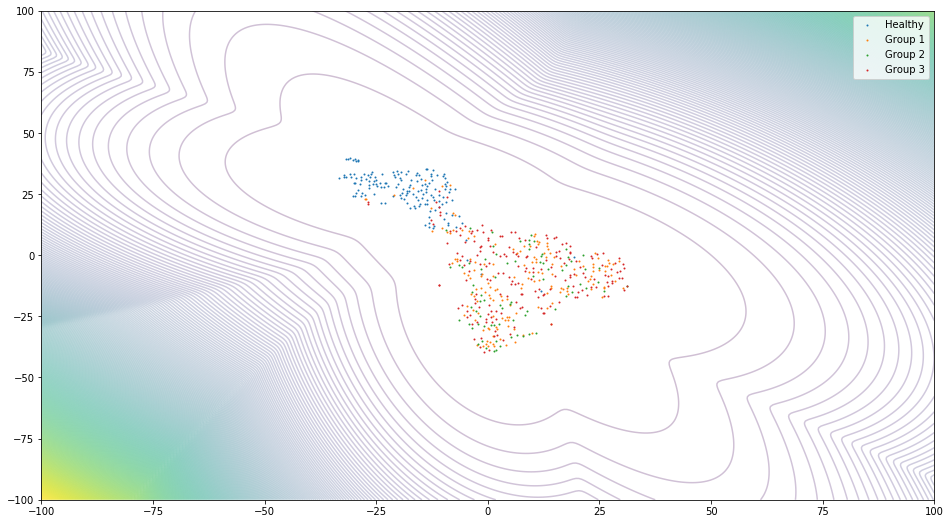

In [41]:
fig,axs = plt.subplots(figsize=(16,9))
x = np.linspace(-100., 100.,num=300)
y = np.linspace(-100., 100.,num=300)
X, Y = np.meshgrid(x, y)
XX = np.array([X.ravel(), Y.ravel()]).T
Z = -model_dif.score_samples(XX)
Z = Z.reshape(X.shape)

CS = axs.contour(X, Y, Z,levels=np.sqrt(np.linspace(np.min(Z),np.max(Z)**2,400)),alpha=.25)

for i in range(4):
    dslice = [np.where(data_dif["Target_dif"]==i)[0]]

    axs.scatter(ProstateReduced2_dif[:,0][dslice],ProstateReduced2_dif[:,1][dslice],s=1,label=nameDict_dif[i])
    
axs.legend()

In [334]:
model_Group1Group3 = GaussianMixture(n_components=2)
Group1 = [np.where(data_dif["Target_dif"]==1)[0]]
Group3 = [np.where(data_dif["Target_dif"]==3)[0]]
Group1_0 = pd.DataFrame(ProstateReduced2_dif[:,0][Group1])
Group1_1 = pd.DataFrame(ProstateReduced2_dif[:,1][Group1])
Group3_0 = pd.DataFrame(ProstateReduced2_dif[:,0][Group3])
Group3_1 = pd.DataFrame(ProstateReduced2_dif[:,1][Group3])
Group1Reduced2 = pd.concat([Group1_0, Group1_1], axis=1)
Group3Reduced2 = pd.concat([Group3_0, Group3_1], axis=1)
Group1Group3Reduced2 = Group1Reduced2.append(Group3Reduced2)
model_Group1Group3.fit(Group1Group3Reduced2)

GaussianMixture(covariance_type='full', init_params='kmeans', max_iter=100,
        means_init=None, n_components=2, n_init=1, precisions_init=None,
        random_state=None, reg_covar=1e-06, tol=0.001, verbose=0,
        verbose_interval=10, warm_start=False, weights_init=None)

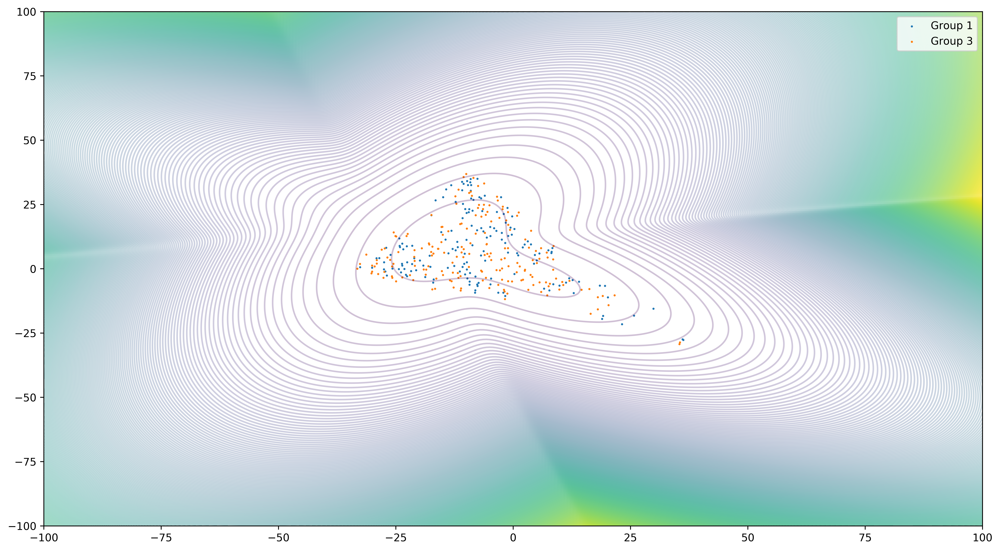

In [335]:
fig,axs = plt.subplots(figsize=(16,9))
x = np.linspace(-100., 100.,num=300)
y = np.linspace(-100., 100.,num=300)
X, Y = np.meshgrid(x, y)
XX = np.array([X.ravel(), Y.ravel()]).T
Z = -model_Group1Group3.score_samples(XX)
Z = Z.reshape(X.shape)

CS = axs.contour(X, Y, Z,levels=np.sqrt(np.linspace(np.min(Z),np.max(Z)**2,400)),alpha=.25)

for i in [1,3]:
    dslice = [np.where(data_dif["Target_dif"]==i)[0]]

    axs.scatter(ProstateReduced2_dif[:,0][dslice],ProstateReduced2_dif[:,1][dslice],s=1,label=nameDict_dif[i])
    
axs.legend()

## Supervised Learning

### SVM, LinearSVM, and RF

#### Finding for Best Features

In [42]:
pipe_dif = Pipeline([
    ('classify', SVC())])

In [43]:
GAMMA_OPTIONS = [1e-3, 1e-4]
C_OPTIONS = [1, 10, 100, 1000]

N_NEIGHBORS_OPTIONS = list(range(1,30))

n_estimators = [10,20,40]
max_depth = [5, None]
min_samples_split = [2, 5, 10]
min_samples_leaf = [1, 2, 4]


param_grid_dif = [ 
     {
        'classify': [LinearSVC()],
        'classify__C': C_OPTIONS, 
    },
    {
        'classify': [SVC()],
        'classify__C': C_OPTIONS,
        'classify__kernel': ['rbf'], 
        'classify__gamma': GAMMA_OPTIONS,
    },
    {
        'classify': [RandomForestClassifier()],
        'classify__n_estimators': n_estimators,
        'classify__max_depth': max_depth,
        'classify__min_samples_split': min_samples_split,
        'classify__min_samples_leaf': min_samples_leaf,
    },
    {
        'classify': [KNeighborsClassifier()],
        'classify__n_neighbors': N_NEIGHBORS_OPTIONS,
    },
]



In [44]:
scoring = make_scorer(f1_score, average='macro')

In [45]:
clf_dif = GridSearchCV(pipe_dif, param_grid_dif, cv=StratifiedKFold(n_splits=5, shuffle=True, random_state=42), iid = False, verbose = 10, scoring=scoring, n_jobs=-1)

In [46]:
clf_dif.fit(X_train_MI_dif, y_train_dif)

Fitting 5 folds for each of 95 candidates, totalling 475 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Batch computation too fast (0.1725s.) Setting batch_size=2.
[Parallel(n_jobs=-1)]: Done   5 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done  12 tasks      | elapsed:    0.6s
[Parallel(n_jobs=-1)]: Done  26 tasks      | elapsed:    0.9s
[Parallel(n_jobs=-1)]: Done  40 tasks      | elapsed:    1.0s
[Parallel(n_jobs=-1)]: Batch computation too fast (0.1975s.) Setting batch_size=4.
[Parallel(n_jobs=-1)]: Done  58 tasks      | elapsed:    1.2s
[Parallel(n_jobs=-1)]: Done  88 tasks      | elapsed:    2.3s
[Parallel(n_jobs=-1)]: Done 132 tasks      | elapsed:    3.9s
[Parallel(n_jobs=-1)]: Done 176 tasks      | elapsed:    5.2s
[Parallel(n_jobs=-1)]: Done 228 tasks      | elapsed:    7.0s
[Parallel(n_jobs=-1)]: Done 280 tasks      | elapsed:    8.7s
[Parallel(n_jobs=-1)]: Done 340 tasks      | elapsed:   10.2s
[Parallel(n_jobs=-1)]: Done 400 tasks      | elapsed:   10.6s
[Parallel(n_jo

GridSearchCV(cv=StratifiedKFold(n_splits=5, random_state=42, shuffle=True),
       error_score='raise-deprecating',
       estimator=Pipeline(memory=None,
     steps=[('classify', SVC(C=1.0, cache_size=200, class_weight=None, coef0=0.0,
  decision_function_shape='ovr', degree=3, gamma='auto_deprecated',
  kernel='rbf', max_iter=-1, probability=False, random_state=None,
  shrinking=True, tol=0.001, verbose=False))]),
       fit_params=None, iid=False, n_jobs=-1,
       param_grid=[{'classify': [LinearSVC(C=1.0, class_weight=None, dual=True, fit_intercept=True,
     intercept_scaling=1, loss='squared_hinge', max_iter=1000,
     multi_class='ovr', penalty='l2', random_state=None, tol=0.0001,
     verbose=0)], 'classify__C': [1, 10, 100, 1000]}, {'classify': [SVC(C=1... 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]}],
       pre_dispatch='2*n_jobs', refit=True, return_train_score='warn',
       scoring=make_scorer(f1_score, average=macro)

In [47]:
print("Best parameters set found on development set:")
print()
print(clf_dif.best_params_)
print()
print("Grid scores on development set:")
print()
means_dif = clf_dif.cv_results_['mean_test_score']
stds_dif = clf_dif.cv_results_['std_test_score']
for mean, std, params in zip(means_dif, stds_dif, clf_dif.cv_results_['params']):
    print("%0.3f (+/-%0.03f) for %r"
            % (mean, std * 2, params))
print()

print("Detailed classification report:")
print()
print("The model is trained on the full development set.")
print("The scores are computed on the full evaluation set.")
print()
y_true_dif, y_pred_dif = y_test_dif, clf_dif.predict(X_test_MI_dif)
print(classification_report(y_true_dif, y_pred_dif))
print()

Best parameters set found on development set:

{'classify': RandomForestClassifier(bootstrap=True, class_weight=None, criterion='gini',
            max_depth=None, max_features='auto', max_leaf_nodes=None,
            min_impurity_decrease=0.0, min_impurity_split=None,
            min_samples_leaf=1, min_samples_split=5,
            min_weight_fraction_leaf=0.0, n_estimators=40, n_jobs=None,
            oob_score=False, random_state=None, verbose=0,
            warm_start=False), 'classify__max_depth': None, 'classify__min_samples_leaf': 1, 'classify__min_samples_split': 5, 'classify__n_estimators': 40}

Grid scores on development set:

0.438 (+/-0.044) for {'classify': LinearSVC(C=1.0, class_weight=None, dual=True, fit_intercept=True,
     intercept_scaling=1, loss='squared_hinge', max_iter=1000,
     multi_class='ovr', penalty='l2', random_state=None, tol=0.0001,
     verbose=0), 'classify__C': 1}
0.408 (+/-0.183) for {'classify': LinearSVC(C=1.0, class_weight=None, dual=True, fit_in

#### Trying With MI

In [48]:
rf_classifier_dif = RandomForestClassifier(bootstrap=True, class_weight=None, criterion='gini',
            max_depth=None, max_features='auto', max_leaf_nodes=None,
            min_impurity_decrease=0.0, min_impurity_split=None,
            min_samples_leaf=1, min_samples_split=5,
            min_weight_fraction_leaf=0.0, n_estimators=40, n_jobs=None,
            oob_score=False, random_state=None, verbose=0,
            warm_start=False)

In [49]:
rf_classifier_dif.fit(X_train_MI_dif, y_train_dif)

RandomForestClassifier(bootstrap=True, class_weight=None, criterion='gini',
            max_depth=None, max_features='auto', max_leaf_nodes=None,
            min_impurity_decrease=0.0, min_impurity_split=None,
            min_samples_leaf=1, min_samples_split=5,
            min_weight_fraction_leaf=0.0, n_estimators=40, n_jobs=None,
            oob_score=False, random_state=None, verbose=0,
            warm_start=False)

In [50]:
preds_dif = rf_classifier_dif.predict(X_test_MI_dif)

In [51]:
print(classification_report(y_test_dif, preds_dif))

              precision    recall  f1-score   support

           0       0.89      1.00      0.94        31
           1       0.64      0.78      0.70        32
           2       0.00      0.00      0.00        16
           3       0.64      0.68      0.66        37

   micro avg       0.70      0.70      0.70       116
   macro avg       0.54      0.61      0.58       116
weighted avg       0.62      0.70      0.66       116



## Dummy Classifier

In [52]:
dummy_dif = DummyClassifier()

In [53]:
dummy_dif.fit(X_train_MI_dif, y_train_dif)

DummyClassifier(constant=None, random_state=None, strategy='stratified')

In [54]:
y_dummy_pred_dif = dummy_dif.predict(X_test_MI_dif)

In [55]:
print(classification_report(y_test_dif, y_dummy_pred_dif))

              precision    recall  f1-score   support

           0       0.26      0.23      0.24        31
           1       0.20      0.22      0.21        32
           2       0.06      0.06      0.06        16
           3       0.42      0.41      0.41        37

   micro avg       0.26      0.26      0.26       116
   macro avg       0.23      0.23      0.23       116
weighted avg       0.27      0.26      0.26       116

